# Определение стоимости автомобилей

Сервис по продаже автомобилей с пробегом «Не бит, не крашен» разрабатывает приложение для привлечения новых клиентов. В нём можно быстро узнать рыночную стоимость своего автомобиля. В вашем распоряжении исторические данные: технические характеристики, комплектации и цены автомобилей. Вам нужно построить модель для определения стоимости. 

Заказчику важны:

- качество предсказания;
- скорость предсказания;
- время обучения.

# План выполнения

<br>1. Загрузка данных.<br>2. Изучение и предобработка данных. <br>
-Заполнить пропущенные значения и обработать аномалии в столбцах. Если среди признаков имеются неинформативные, удалить их.<br>3. Подготовка выборок для обучения моделей.<br>4. Обучение разных моделей, одна из которых — LightGBM, как минимум одна — не бустинг. Для каждой модели пробуем разные гиперпараметры.<br>5. Анализ время обучения, время предсказания и качество моделей.<br>6. Опираясь на критерии заказчика, выбрать лучшую модель, проверить её качество на тестовой выборке.<br><br>

## Подготовка данных

In [1]:
import pandas as pd
import numpy as np
from numpy import mean
from numpy import std
import matplotlib.pyplot as plt
import seaborn as sns
import plotly
import plotly.graph_objs as go
import plotly.express as px
from plotly.subplots import make_subplots
import math
import time
from sklearn.preprocessing import OneHotEncoder, OrdinalEncoder, StandardScaler
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV
from sklearn.model_selection import RandomizedSearchCV
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error
from sklearn.datasets import make_regression
from catboost import CatBoostRegressor
import lightgbm as lgb
from lightgbm import LGBMRegressor

In [2]:
# открытие файла

try:
    df = pd.read_csv('/datasets/autos.csv')
except:
    df = pd.read_csv('autos.csv')

In [3]:
# первые 5 строк

df.head()

,DateCrawled,Price,VehicleType,RegistrationYear,Gearbox,Power,Model,Kilometer,RegistrationMonth,FuelType,Brand,Repaired,DateCreated,NumberOfPictures,PostalCode,LastSeen
0,2016-03-24 11:52:17,480,NaN,1993,manual,0,golf,150000,0,petrol,volkswagen,NaN,2016-03-24 00:00:00,0,70435,2016-04-07 03:16:57
1,2016-03-24 10:58:45,18300,coupe,2011,manual,190,NaN,125000,5,gasoline,audi,yes,2016-03-24 00:00:00,0,66954,2016-04-07 01:46:50
2,2016-03-14 12:52:21,9800,suv,2004,auto,163,grand,125000,8,gasoline,jeep,NaN,2016-03-14 00:00:00,0,90480,2016-04-05 12:47:46
3,2016-03-17 16:54:04,1500,small,2001,manual,75,golf,150000,6,petrol,volkswagen,no,2016-03-17 00:00:00,0,91074,2016-03-17 17:40:17
4,2016-03-31 17:25:20,3600,small,2008,manual,69,fabia,90000,7,gasoline,skoda,no,2016-03-31 00:00:00,0,60437,2016-04-06 10:17:21


**Описание данных:**<br><br>
**Признаки**<br><br>DateCrawled — дата скачивания анкеты из базы<br>VehicleType — тип автомобильного кузова<br>
RegistrationYear — год регистрации автомобиля<br>Gearbox — тип коробки передач<br>Power — мощность (л. с.)<br>Model — модель автомобиля<br>Kilometer — пробег (км)<br>RegistrationMonth — месяц регистрации автомобиля<br>FuelType — тип топлива<br>Brand — марка автомобиля<br>Repaired — была машина в ремонте или нет<br>DateCreated — дата создания анкеты<br>NumberOfPictures — количество фотографий автомобиля<br>PostalCode — почтовый индекс владельца анкеты (пользователя)<br>LastSeen — дата последней активности пользователя<br><br>**Целевой признак**<br><br>Price — цена (евро)

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 354369 entries, 0 to 354368
Data columns (total 16 columns):
 #   Column             Non-Null Count   Dtype 
---  ------             --------------   ----- 
 0   DateCrawled        354369 non-null  object
 1   Price              354369 non-null  int64 
 2   VehicleType        316879 non-null  object
 3   RegistrationYear   354369 non-null  int64 
 4   Gearbox            334536 non-null  object
 5   Power              354369 non-null  int64 
 6   Model              334664 non-null  object
 7   Kilometer          354369 non-null  int64 
 8   RegistrationMonth  354369 non-null  int64 
 9   FuelType           321474 non-null  object
 10  Brand              354369 non-null  object
 11  Repaired           283215 non-null  object
 12  DateCreated        354369 non-null  object
 13  NumberOfPictures   354369 non-null  int64 
 14  PostalCode         354369 non-null  int64 
 15  LastSeen           354369 non-null  object
dtypes: int64(7), object(

In [5]:
print('Размер исходных данных:', df.shape, 'Количество ячеек:', df.size)

Размер исходных данных: (354369, 16) Количество ячеек: 5669904


In [6]:
# проверка наличия явных дубликатов

print('Количество явных дубликатов', df.duplicated().sum())

Количество явных дубликатов 4


In [7]:
# удаление явных дубликатов

df = df.drop_duplicates()
print('Количество явных дубликатов', df.duplicated().sum())

Количество явных дубликатов 0


In [8]:
df.columns

Index(['DateCrawled', 'Price', 'VehicleType', 'RegistrationYear', 'Gearbox',
       'Power', 'Model', 'Kilometer', 'RegistrationMonth', 'FuelType', 'Brand',
       'Repaired', 'DateCreated', 'NumberOfPictures', 'PostalCode',
       'LastSeen'],
      dtype='object')

In [9]:
# приведем названия столбцов к корректному виду:
# добавим разделитель _
# приведем к нижнему регистру, удалим пробелы в начале и в конце

df = df.rename(columns = {'DateCrawled': 'Date_Crawled', 'VehicleType': 'Vehicle_Type', 
                          'RegistrationYear': 'Registration_Year', 
                          'RegistrationMonth': 'Registration_Month', 'FuelType': 'Fuel_Type',
                          'DateCreated': 'Date_Created', 'NumberOfPictures': 'Number_Of_Pictures',
                          'PostalCode': 'Postal_Code', 'LastSeen': 'Last_Seen'})
df.columns = df.columns.str.lower()
df.columns = df.columns.str.strip()

In [10]:
df.columns

Index(['date_crawled', 'price', 'vehicle_type', 'registration_year', 'gearbox',
       'power', 'model', 'kilometer', 'registration_month', 'fuel_type',
       'brand', 'repaired', 'date_created', 'number_of_pictures',
       'postal_code', 'last_seen'],
      dtype='object')

In [11]:
# Количество пропусков в столбцах

df.isna().sum()

date_crawled              0
price                     0
vehicle_type          37490
registration_year         0
gearbox               19833
power                     0
model                 19705
kilometer                 0
registration_month        0
fuel_type             32895
brand                     0
repaired              71154
date_created              0
number_of_pictures        0
postal_code               0
last_seen                 0
dtype: int64

In [12]:
df['number_of_pictures'].unique()

array([0], dtype=int64)

In [13]:
# посмотрим подробнее столбцы с датами (date_crawled - дата скачивания анкеты из базы, date_created - дата создания анкеты, 
# и last_seen)

all_date = ['date_crawled', 'registration_year', 'date_created', 'last_seen']

for d in all_date:
    print(d)
    print(df[d].min())
    print(df[d].max())
    print()

date_crawled
2016-03-05 14:06:22
2016-04-07 14:36:58

registration_year
1000
9999

date_created
2014-03-10 00:00:00
2016-04-07 00:00:00

last_seen
2016-03-05 14:15:08
2016-04-07 14:58:51



Данные в столбце registration_year' (год регистрации автомобиля) не совпадают с временным промежутком столбцов date_crawled - дата скачивания анкеты из базы, date_created - дата создания анкеты, и last_seen. Для registration_year' требуется обработка аномалий.

Разберем столбцы:<br> - столбцы с датами: 'date_crawled' (дата скачивания анкеты из базы), 'registration_year' (год регистрации автомобиля), 'registration_month' (месяц регистрации автомобиля), 'date_created' (дата создания анкеты), 'last_seen' (дата последней активности пользователя) - из всех этих столбцов на цену влияет только **'registration_year' (год регистрации автомобиля)**, остальные можно удалить;<br> - столбец 'number_of_pictures' (количество фотографий автомобиля) имеет нулевые данные и, соответственно, не информативен; <br>'postal_code' (почтовый индекс владельца) не влияет на цену, удаляем

In [14]:
# удаляем неинформативные столбцы
# 'number_of_pictures'
df = df.drop(['date_created', 'registration_month', 'date_crawled', 'number_of_pictures', 
           'postal_code', 'last_seen'], axis=1)

In [15]:
df.columns

Index(['price', 'vehicle_type', 'registration_year', 'gearbox', 'power',
       'model', 'kilometer', 'fuel_type', 'brand', 'repaired'],
      dtype='object')

In [16]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 354365 entries, 0 to 354368
Data columns (total 10 columns):
 #   Column             Non-Null Count   Dtype 
---  ------             --------------   ----- 
 0   price              354365 non-null  int64 
 1   vehicle_type       316875 non-null  object
 2   registration_year  354365 non-null  int64 
 3   gearbox            334532 non-null  object
 4   power              354365 non-null  int64 
 5   model              334660 non-null  object
 6   kilometer          354365 non-null  int64 
 7   fuel_type          321470 non-null  object
 8   brand              354365 non-null  object
 9   repaired           283211 non-null  object
dtypes: int64(4), object(6)
memory usage: 29.7+ MB


In [17]:
df.head()

,price,vehicle_type,registration_year,gearbox,power,model,kilometer,fuel_type,brand,repaired
0,480,NaN,1993,manual,0,golf,150000,petrol,volkswagen,NaN
1,18300,coupe,2011,manual,190,NaN,125000,gasoline,audi,yes
2,9800,suv,2004,auto,163,grand,125000,gasoline,jeep,NaN
3,1500,small,2001,manual,75,golf,150000,petrol,volkswagen,no
4,3600,small,2008,manual,69,fabia,90000,gasoline,skoda,no


In [18]:
print('Размер данных:', df.shape, 'Количество ячеек:', df.size)

Размер данных: (354365, 10) Количество ячеек: 3543650


In [19]:
# уникальные значения столбца 'vehicle_type' (тип автомобильного кузова)

df['vehicle_type'].unique()

array([nan, 'coupe', 'suv', 'small', 'sedan', 'convertible', 'bus',
       'wagon', 'other'], dtype=object)

In [20]:
# уникальные значения столбца 'gearbox' (тип коробки передач)

df['gearbox'].unique()

array(['manual', 'auto', nan], dtype=object)

In [21]:
# уникальные значения столбца 'fuel_type' (тип топлива)

df['fuel_type'].unique()

array(['petrol', 'gasoline', nan, 'lpg', 'other', 'hybrid', 'cng',
       'electric'], dtype=object)

In [22]:
# уникальные значения столбца 'model' (модель автомобиля), + удалим пробелы в названиях

df['model'] = df['model'].str.strip()
df['model'].sort_values().unique()

array(['100', '145', '147', '156', '159', '1_reihe', '1er', '200',
       '2_reihe', '300c', '3_reihe', '3er', '4_reihe', '500', '5_reihe',
       '5er', '601', '6_reihe', '6er', '7er', '80', '850', '90', '900',
       '9000', '911', 'a1', 'a2', 'a3', 'a4', 'a5', 'a6', 'a8',
       'a_klasse', 'accord', 'agila', 'alhambra', 'almera', 'altea',
       'amarok', 'antara', 'arosa', 'astra', 'auris', 'avensis', 'aveo',
       'aygo', 'b_klasse', 'b_max', 'beetle', 'berlingo', 'bora',
       'boxster', 'bravo', 'c1', 'c2', 'c3', 'c4', 'c5', 'c_klasse',
       'c_max', 'c_reihe', 'caddy', 'calibra', 'captiva', 'carisma',
       'carnival', 'cayenne', 'cc', 'ceed', 'charade', 'cherokee',
       'citigo', 'civic', 'cl', 'clio', 'clk', 'clubman', 'colt', 'combo',
       'cooper', 'cordoba', 'corolla', 'corsa', 'cr_reihe', 'croma',
       'crossfire', 'cuore', 'cx_reihe', 'defender', 'delta', 'discovery',
       'doblo', 'ducato', 'duster', 'e_klasse', 'elefantino', 'eos',
       'escort', 'espac

In [23]:
# уникальные значения столбца 'brand' (марка автомобиля), + удалим пробелы в названиях

df['brand'] = df['brand'].str.strip()
df['brand'].sort_values().unique()

array(['alfa_romeo', 'audi', 'bmw', 'chevrolet', 'chrysler', 'citroen',
       'dacia', 'daewoo', 'daihatsu', 'fiat', 'ford', 'honda', 'hyundai',
       'jaguar', 'jeep', 'kia', 'lada', 'lancia', 'land_rover', 'mazda',
       'mercedes_benz', 'mini', 'mitsubishi', 'nissan', 'opel', 'peugeot',
       'porsche', 'renault', 'rover', 'saab', 'seat', 'skoda', 'smart',
       'sonstige_autos', 'subaru', 'suzuki', 'toyota', 'trabant',
       'volkswagen', 'volvo'], dtype=object)

In [24]:
df['repaired'].unique()

array([nan, 'yes', 'no'], dtype=object)

In [25]:
df['repaired'] = df['repaired'].fillna('unknown')

In [26]:
df['repaired'].unique()

array(['unknown', 'yes', 'no'], dtype=object)

Исследуем числловые столбцы: price (цена), registration_year (год регистрации), power(мощность), kilometer(пробег, км).

Исследуем целевой признак

In [27]:
# целевой признак

df['price'].describe()

count    354365.000000
mean       4416.679830
std        4514.176349
min           0.000000
25%        1050.000000
50%        2700.000000
75%        6400.000000
max       20000.000000
Name: price, dtype: float64

In [28]:
# авто 500 и менее евро

df.loc[df['price'] <= 500]

,price,vehicle_type,registration_year,gearbox,power,model,kilometer,fuel_type,brand,repaired
0,480,NaN,1993,manual,0,golf,150000,petrol,volkswagen,unknown
7,0,sedan,1980,manual,50,other,40000,petrol,volkswagen,no
15,450,small,1910,NaN,0,ka,5000,petrol,ford,unknown
16,300,NaN,2016,NaN,60,polo,150000,petrol,volkswagen,unknown
23,450,small,1997,manual,50,arosa,150000,petrol,seat,no
...,...,...,...,...,...,...,...,...,...,...
354318,400,wagon,1991,manual,0,legacy,150000,petrol,subaru,unknown
354329,350,small,1996,NaN,65,punto,150000,NaN,fiat,unknown
354335,390,small,1997,auto,0,corsa,100000,petrol,opel,yes
354338,180,NaN,1995,NaN,0,NaN,125000,petrol,opel,unknown


По архивным данным на 2016 год цены на данные авто превышали 500 евро, поэтому удаляем авто с нулевой ценой и менее 500 евро.

In [29]:
# оставляем в данных только авто без нулевой цены и авто дороже 500 евро

df = df.loc[df['price'] > 500]
(df['price'].value_counts())

1500     5394
1000     4648
1200     4594
2500     4438
600      3819
         ... 
15001       1
12696       1
13879       1
12440       1
8188        1
Name: price, Length: 3466, dtype: int64

In [30]:
# исследуем целевой признак

print(df['price'].value_counts())
print()
fig = go.Figure()
fig.add_trace(go.Box(y=df['price'], name='Цена (евро)'))
fig.update_layout(title='Диаграмма размаха столбца "price"')
fig.show()

1500     5394
1000     4648
1200     4594
2500     4438
600      3819
         ... 
15001       1
12696       1
13879       1
12440       1
8188        1
Name: price, Length: 3466, dtype: int64



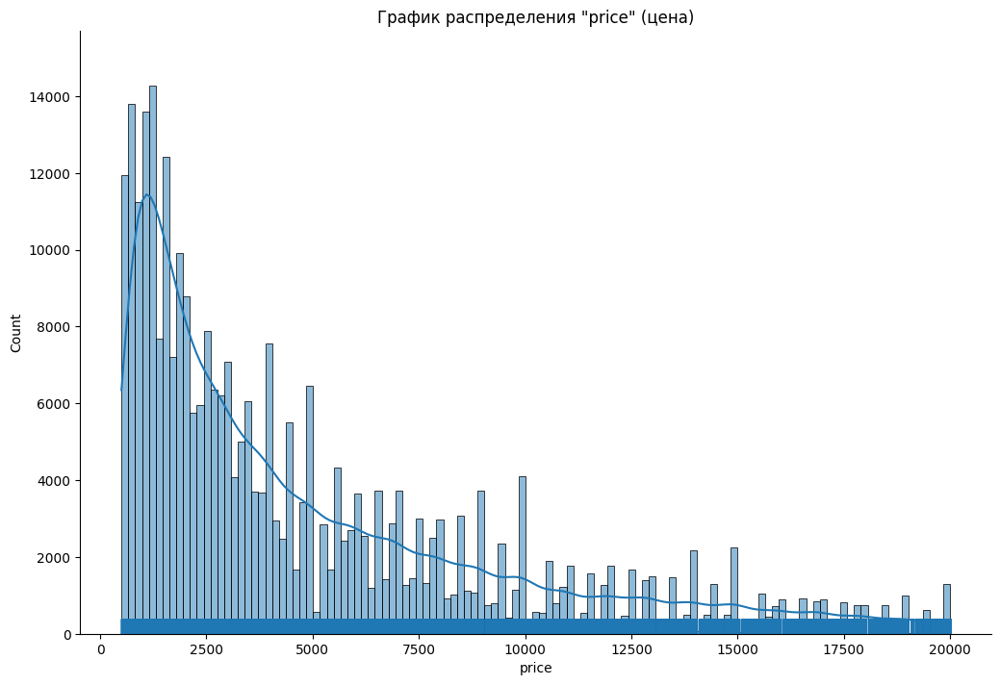

In [31]:
sns.displot(data=df['price'], kind='hist', rug=True, kde=True, height= 7, aspect= 1.5)
plt.title('График распределения "price" (цена)')
plt.show()

In [32]:
df['price'].describe()

count    312641.000000
mean       4974.823881
std        4521.813632
min         501.000000
25%        1500.000000
50%        3300.000000
75%        6999.000000
max       20000.000000
Name: price, dtype: float64

In [33]:
print('Размер данных:', df.shape, 'Количество ячеек:', df.size)

Размер данных: (312641, 10) Количество ячеек: 3126410


Удалили 11% строк. Распределение правосторонее унимодальное. Среднее значение отличается от медианы (4775 и 3300 соответственно). Данные выше max_quant_price не удаляем, так как там плавное равномерно убывают без разрывов. Строки ниже min_quant_price удалили, так как их маленький процент и в основном старые машины

Исследуем год регистрации автомобиля

In [34]:
df['registration_year'].sort_values().unique()

array([1000, 1001, 1039, 1234, 1400, 1500, 1600, 1800, 1910, 1923, 1925,
       1927, 1928, 1929, 1930, 1931, 1932, 1933, 1934, 1935, 1936, 1937,
       1938, 1940, 1941, 1942, 1943, 1944, 1945, 1946, 1947, 1948, 1949,
       1950, 1951, 1952, 1953, 1954, 1955, 1956, 1957, 1958, 1959, 1960,
       1961, 1962, 1963, 1964, 1965, 1966, 1967, 1968, 1969, 1970, 1971,
       1972, 1973, 1974, 1975, 1976, 1977, 1978, 1979, 1980, 1981, 1982,
       1983, 1984, 1985, 1986, 1987, 1988, 1989, 1990, 1991, 1992, 1993,
       1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004,
       2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015,
       2016, 2017, 2018, 2019, 2066, 2290, 2500, 2800, 2900, 3000, 3200,
       3700, 4000, 4100, 4500, 5000, 5300, 5555, 5911, 6000, 7000, 7100,
       7800, 8500, 8888, 9000, 9450, 9999], dtype=int64)

In [35]:
print(df['registration_year'].sort_values(ascending=False).value_counts())
print()
fig = go.Figure()
fig.add_trace(go.Box(y=df['registration_year'], name='Год регистрации авто'))
fig.update_layout(title='Диаграмма размаха столбца "registration_year"')
fig.show()

2005    20984
2006    19599
2000    19253
2004    19183
2003    19159
        ...  
1949        1
5300        1
8888        1
7100        1
2290        1
Name: registration_year, Length: 127, dtype: int64



In [36]:
df['registration_year'].describe()

count    312641.000000
mean       2004.225127
std          64.356577
min        1000.000000
25%        2000.000000
50%        2004.000000
75%        2008.000000
max        9999.000000
Name: registration_year, dtype: float64

Так как год скачивания анкеты 2016, и год последней активности пользователя также 2016, удаляем аномальные значения выше этой даты.
Таже удалим авто старше 40 лет (до 1976 года).

In [37]:
df = df.loc[((df['registration_year'] >= 1976) & (df['registration_year'] <= 2016))]

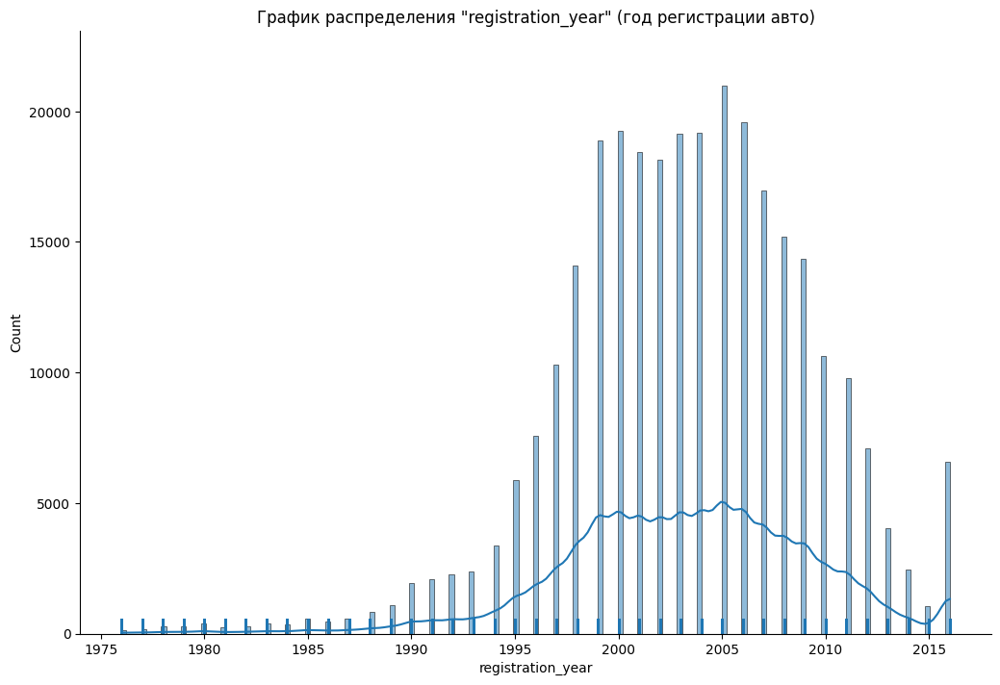

In [38]:
sns.displot(data=df['registration_year'], kind='hist', rug=True, kde=True, height= 7, aspect= 1.5)
plt.title('График распределения "registration_year" (год регистрации авто)')
plt.show()

In [39]:
fig = go.Figure()
fig.add_trace(go.Box(y=df['registration_year'], name='Год регистрации авто'))
fig.update_layout(title='Диаграмма размаха столбца "registration_year"')
fig.show()

In [40]:
print('Размер данных:', df.shape, 'Количество ячеек:', df.size)

Размер данных: (297711, 10) Количество ячеек: 2977110


Исследуем столбец "power" мощность (л.с.). Пропуски в нем отсутствуют

In [41]:
df['power'].sort_values().unique()

array([    0,     1,     2,     3,     4,     5,     6,     7,     8,
           9,    10,    11,    12,    13,    14,    15,    16,    17,
          18,    19,    20,    21,    22,    23,    24,    25,    26,
          27,    28,    29,    30,    31,    33,    34,    35,    36,
          37,    38,    39,    40,    41,    42,    43,    44,    45,
          46,    47,    48,    49,    50,    51,    52,    53,    54,
          55,    56,    57,    58,    59,    60,    61,    62,    63,
          64,    65,    66,    67,    68,    69,    70,    71,    72,
          73,    74,    75,    76,    77,    78,    79,    80,    81,
          82,    83,    84,    85,    86,    87,    88,    89,    90,
          91,    92,    93,    94,    95,    96,    97,    98,    99,
         100,   101,   102,   103,   104,   105,   106,   107,   108,
         109,   110,   111,   112,   113,   114,   115,   116,   117,
         118,   119,   120,   121,   122,   123,   124,   125,   126,
         127,   128,

In [42]:
print(df['power'].sort_values(ascending=False).value_counts())
print()
fig = go.Figure()
fig.add_trace(go.Box(y=df['power'], name='Мощность, л.с.'))
fig.update_layout(title='Диаграмма размаха столбца "power"')
fig.show()

0        23890
75       18965
150      13292
140      12169
101      11582
         ...  
1082         1
1079         1
2729         1
1704         1
17019        1
Name: power, Length: 642, dtype: int64



In [43]:
df['power'].describe()

count    297711.000000
mean        116.999241
std         184.921508
min           0.000000
25%          75.000000
50%         109.000000
75%         150.000000
max       20000.000000
Name: power, dtype: float64

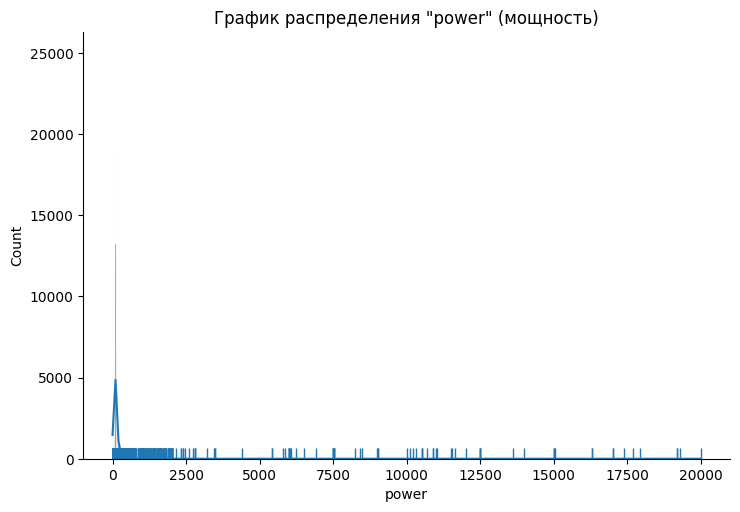

In [44]:
sns.displot(data=df['power'], kind='hist', rug=True, kde=True, height= 5, aspect= 1.5)
plt.title('График распределения "power" (мощность)')
plt.show()

В рейтинге легковых автомобилей по мощности в лошадиных силах есть авто с показателем выше 2000 л.с. Убираем выбросы с мощность более 2300 и авто с показателем 0.

In [45]:
# удалим строки с нулевыми значениями и с мощностью более 220 л.с.

df = (df.loc[(df['power'] != 0) & (df['power'] < 2300)])

In [46]:
fig = go.Figure()
fig.add_trace(go.Box(y=df['power'], name='Мощность, л.с.'))
fig.update_layout(title='Диаграмма размаха столбца "power"')
fig.show()

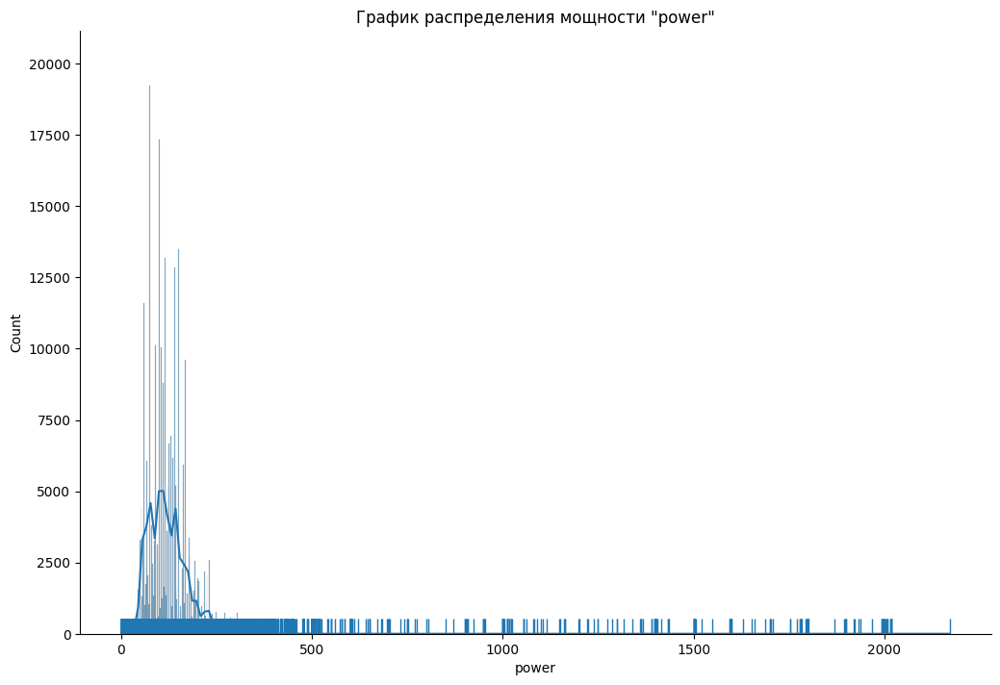

In [47]:
sns.displot(data=df['power'], kind='hist', rug=True, kde=True, height= 7, aspect= 1.5)
plt.title('График распределения мощности "power"')
plt.show()

In [48]:
print('Размер данных:', df.shape, 'Количество ячеек:', df.size)

Размер данных: (273741, 10) Количество ячеек: 2737410


Удалено 22% строк от исходных данных

Исследуем столбец "kilometer" пробег (км). Пропуски в нем отсутствуют

In [49]:
# уникальные значения

df['kilometer'].sort_values().unique()

array([  5000,  10000,  20000,  30000,  40000,  50000,  60000,  70000,
        80000,  90000, 100000, 125000, 150000], dtype=int64)

In [50]:
# уникальные значения

df['kilometer'].describe()

count    273741.000000
mean     127671.594683
std       36902.692684
min        5000.000000
25%      125000.000000
50%      150000.000000
75%      150000.000000
max      150000.000000
Name: kilometer, dtype: float64

In [51]:
print(df['kilometer'].sort_values(ascending=False).value_counts())
print()
fig = go.Figure()
fig.add_trace(go.Box(y=df['kilometer'], name='Пробег (км)'))
fig.update_layout(title='Диаграмма размаха столбца "kilometer"')
fig.show()

150000    178606
125000     30159
100000     12176
90000       9921
80000       8748
70000       7591
60000       6657
50000       5526
40000       4415
30000       3746
20000       3098
5000        2233
10000        865
Name: kilometer, dtype: int64



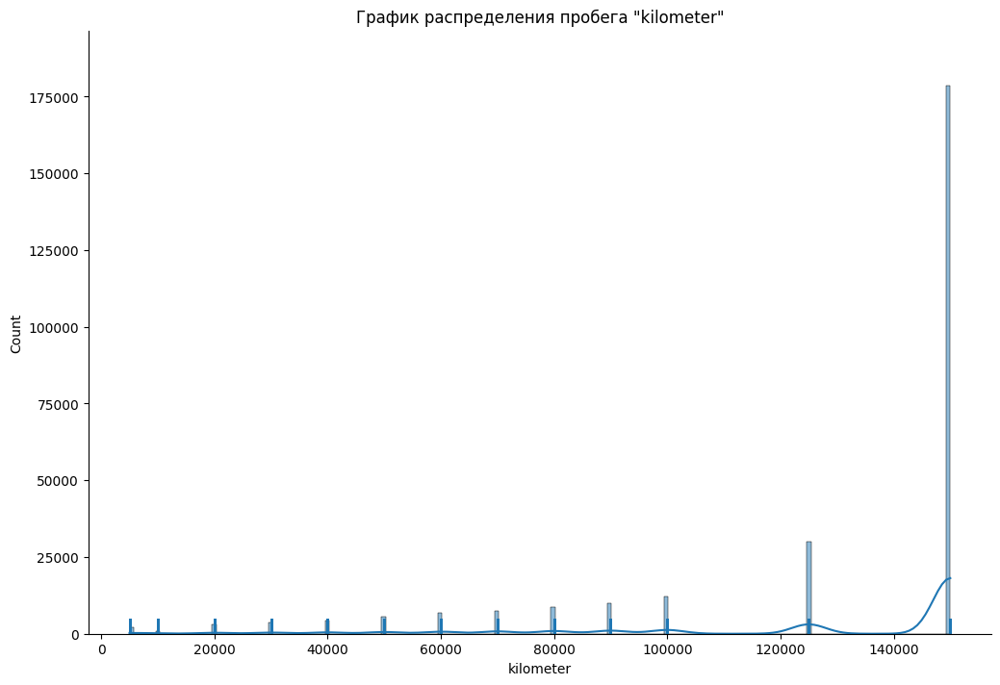

In [52]:
sns.displot(data=df['kilometer'], kind='hist', rug=True, kde=True, height= 7, aspect= 1.5)
plt.title('График распределения пробега "kilometer"')
plt.show()

In [53]:
# Количество пропусков в столбцах

df.isna().sum()

price                    0
vehicle_type          8103
registration_year        0
gearbox               4350
power                    0
model                 9221
kilometer                0
fuel_type            12248
brand                    0
repaired                 0
dtype: int64

In [54]:
# Количество пропусков в процентах в столбцах

for i in df.columns:
    print('Процент пропусков в столбце:', i)
    print(f"{(df[i].isna().mean()):.2%}")

Процент пропусков в столбце: price
0.00%
Процент пропусков в столбце: vehicle_type
2.96%
Процент пропусков в столбце: registration_year
0.00%
Процент пропусков в столбце: gearbox
1.59%
Процент пропусков в столбце: power
0.00%
Процент пропусков в столбце: model
3.37%
Процент пропусков в столбце: kilometer
0.00%
Процент пропусков в столбце: fuel_type
4.47%
Процент пропусков в столбце: brand
0.00%
Процент пропусков в столбце: repaired
0.00%


Количество пропусков после удаления строк<br>
**Итого пропусков в категориальных данных:** vehicle_type (тип автомобильного кузова) - 3372 (1,25%), gearbox (тип коробки передач) - 4019 (1,50%), model (модель автомобиля) - 8587 (3,20%), fuel_type (тип топлива) - 10305 (3,83%).

Оставшиеся пропуски - это категориальные данные. У каждой модели может быть несколько типов кузова, тип топлива. Поэтому заполнить пропуски в типах кузова, типах топлива по бренду и модели не представляется возможным. Так как там не один вариант для замены, то заменим оставшиеся пропуски значением 'unknown'.

In [55]:
df = df.fillna('unknown')

In [56]:
# Количество пропусков в столбцах

df.isna().sum()

price                0
vehicle_type         0
registration_year    0
gearbox              0
power                0
model                0
kilometer            0
fuel_type            0
brand                0
repaired             0
dtype: int64

In [57]:
df.duplicated().sum()

36656

In [58]:
df = df.drop_duplicates()

In [59]:
print('Размер данных:', df.shape, 'Количество ячеек:', df.size)

Размер данных: (237085, 10) Количество ячеек: 2370850


In [60]:
# количество и суммарные продажи по брендам
df_brand_sum = df.pivot_table(index='brand', values='price', aggfunc='sum').sort_values(by='price',
    ascending=False)
df_brand_count = df.pivot_table(index='brand', values='price', aggfunc='count').sort_values(by='price',
    ascending=False)
print('Сумма продаж авто по брендам', df_brand_sum)
print('Количество продаж авто по брендам', df_brand_count)

Сумма продаж авто по брендам                     price
brand                    
volkswagen      262189747
bmw             184781733
mercedes_benz   151812532
audi            150924009
opel             84419775
ford             63061655
renault          31639401
peugeot          28048924
skoda            27900553
mini             24517636
seat             22995070
fiat             19799602
toyota           18508525
mazda            17006198
nissan           16755488
hyundai          15700410
smart            15280708
citroen          14576292
volvo            11205725
kia              10320874
sonstige_autos   10218523
honda             8783443
chevrolet         7572309
mitsubishi        7527719
suzuki            7472657
alfa_romeo        7007285
porsche           6832162
dacia             4423105
chrysler          4267750
jeep              3970402
land_rover        3734264
jaguar            2881451
subaru            2401691
saab              1711982
daihatsu          1068253
lancia   

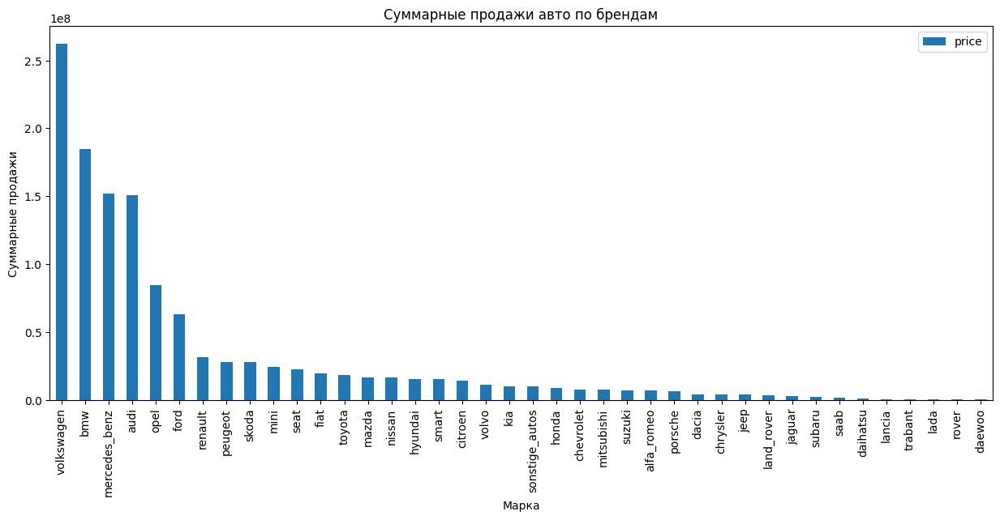

In [61]:
df_brand_sum.plot(kind='bar', y='price', figsize=(15, 6))
plt.legend()
plt.title('Суммарные продажи авто по брендам')
plt.xlabel('Марка')
plt.ylabel('Суммарные продажи')
plt.show()

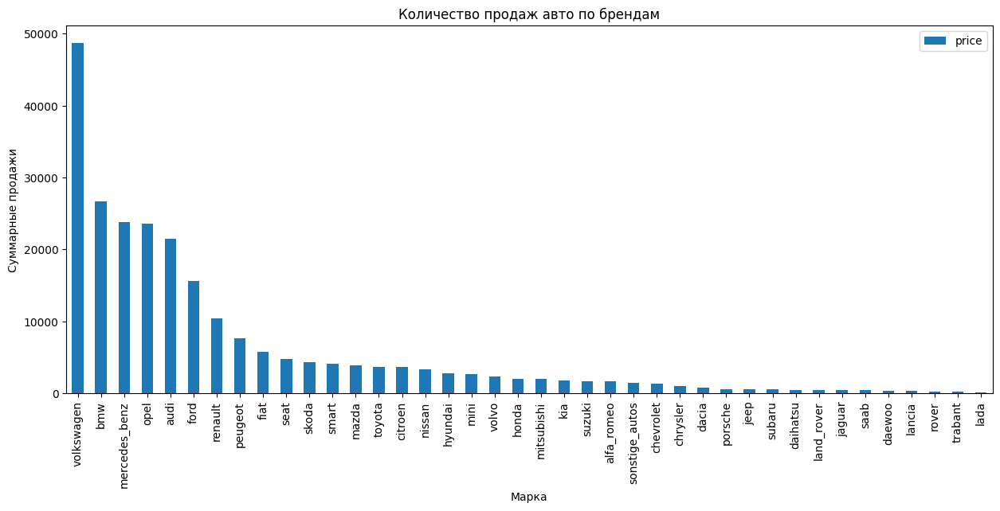

In [62]:
df_brand_count.plot(kind='bar', y='price', figsize=(15, 6))
plt.legend()
plt.title('Количество продаж авто по брендам')
plt.xlabel('Марка')
plt.ylabel('Суммарные продажи')
plt.show()

In [63]:
# количество и суммарные продажи по брендам
df_vehicle_type_sum = df.pivot_table(index='vehicle_type', values='price', 
                                     aggfunc='sum').sort_values(by='price',
    ascending=False)
df_vehicle_type_count = df.pivot_table(index='vehicle_type', values='price', 
                                       aggfunc='count').sort_values(by='price',
    ascending=False)
print('Сумма продаж авто по типу кузова', df_vehicle_type_sum)
print('Количество продаж авто по типу кузова', df_vehicle_type_count)

Сумма продаж авто по типу кузова                   price
vehicle_type           
sedan         356505345
wagon         264117196
small         174812805
bus           134073217
convertible   117482128
suv            90407027
coupe          81875237
unknown        25821099
other           8940128
Количество продаж авто по типу кузова               price
vehicle_type       
sedan         66707
small         50943
wagon         48315
bus           22953
convertible   16336
coupe         12265
suv            9689
unknown        7776
other          2101


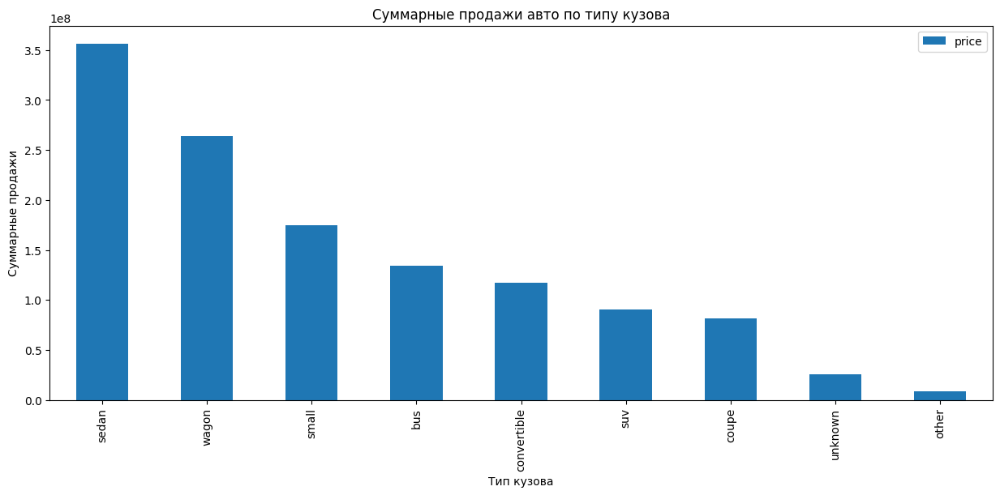

In [64]:
df_vehicle_type_sum.plot(kind='bar', y='price', figsize=(15, 6))
plt.legend()
plt.title('Суммарные продажи авто по типу кузова')
plt.xlabel('Тип кузова')
plt.ylabel('Суммарные продажи')
plt.show()

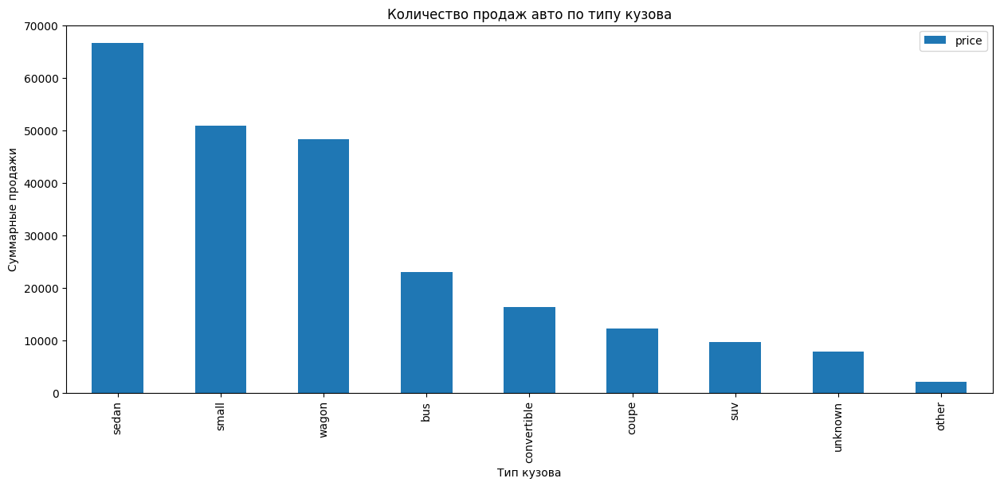

In [65]:
df_vehicle_type_count.plot(kind='bar', y='price', figsize=(15, 6))
plt.legend()
plt.title('Количество продаж авто по типу кузова')
plt.xlabel('Тип кузова')
plt.ylabel('Суммарные продажи')
plt.show()

In [66]:
# количество и суммарные продажи по типу топлива
df_fuel_type_sum = df.pivot_table(index='fuel_type', values='price', 
                                     aggfunc='sum').sort_values(by='price',
    ascending=False)
df_fuel_type_count = df.pivot_table(index='fuel_type', values='price', 
                                       aggfunc='count').sort_values(by='price',
    ascending=False)
print('Сумма продаж авто по типу топлива', df_fuel_type_sum)
print('Количество продаж авто по типу топлива', df_fuel_type_count)

Сумма продаж авто по типу топлива                price
fuel_type           
petrol     663398887
gasoline   527550774
unknown     40277445
lpg         18061516
cng          2022439
hybrid       1958153
electric      543745
other         221223
Количество продаж авто по типу топлива             price
fuel_type        
petrol     145516
gasoline    74783
unknown     11883
lpg          4152
cng           425
hybrid        189
electric       72
other          65


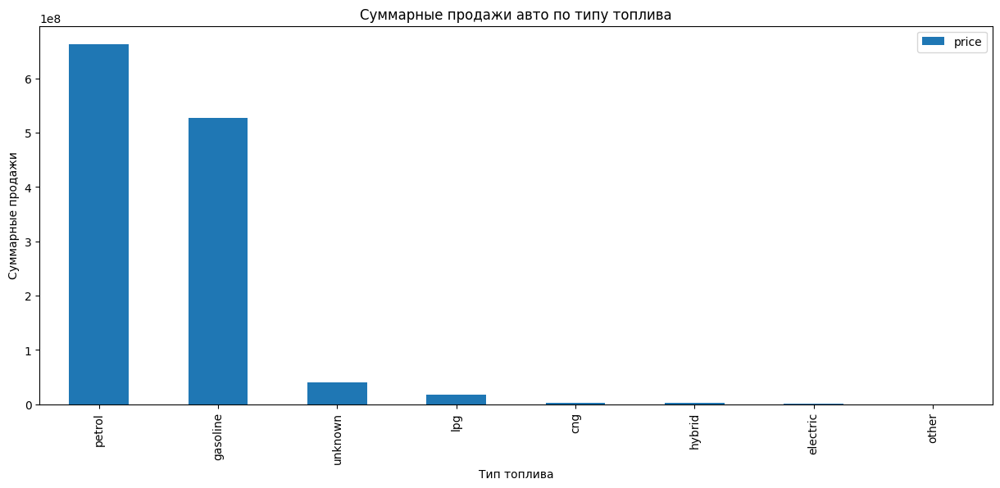

In [67]:
df_fuel_type_sum.plot(kind='bar', y='price', figsize=(15, 6))
plt.legend()
plt.title('Суммарные продажи авто по типу топлива')
plt.xlabel('Тип топлива')
plt.ylabel('Суммарные продажи')
plt.show()

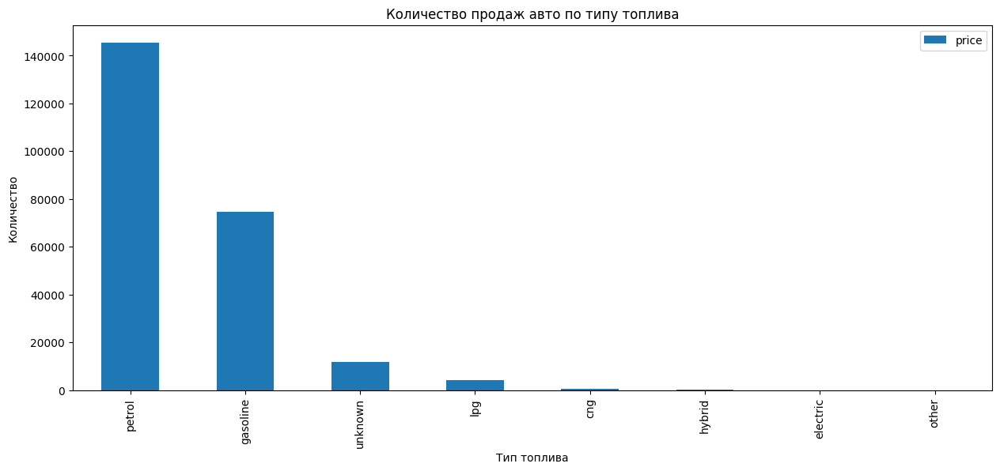

In [68]:
df_fuel_type_count.plot(kind='bar', y='price', figsize=(15, 6))
plt.legend()
plt.title('Количество продаж авто по типу топлива')
plt.xlabel('Тип топлива')
plt.ylabel('Количество')
plt.show()

In [69]:
# количество и суммарные продажи по типу коробки передач
df_gearbox_sum = df.pivot_table(index='gearbox', values='price', 
                                     aggfunc='sum').sort_values(by='price',
    ascending=False)
df_gearbox_count = df.pivot_table(index='gearbox', values='price', 
                                       aggfunc='count').sort_values(by='price',
    ascending=False)
print('Сумма продаж авто по типу коробки передач', df_gearbox_sum)
print('Количество продаж авто по типу коробки передач', df_gearbox_count)

Сумма продаж авто по типу коробки передач              price
gearbox           
manual   866082890
auto     373272792
unknown   14678500
Количество продаж авто по типу коробки передач           price
gearbox        
manual   182127
auto      50780
unknown    4178


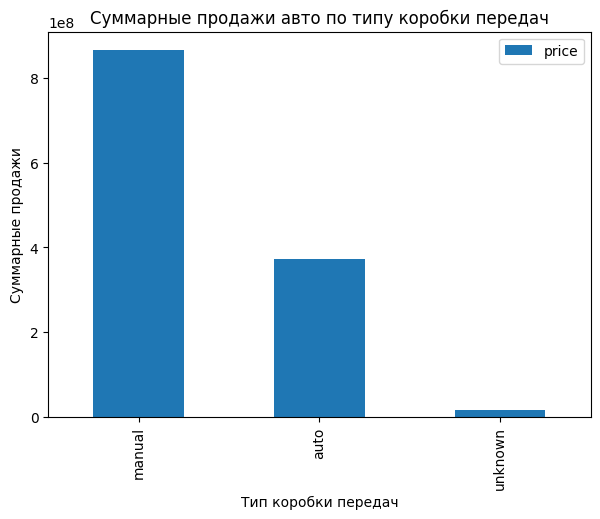

In [70]:
df_gearbox_sum.plot(kind='bar', y='price', figsize=(7, 5))
plt.legend()
plt.title('Суммарные продажи авто по типу коробки передач')
plt.xlabel('Тип коробки передач')
plt.ylabel('Суммарные продажи')
plt.show()

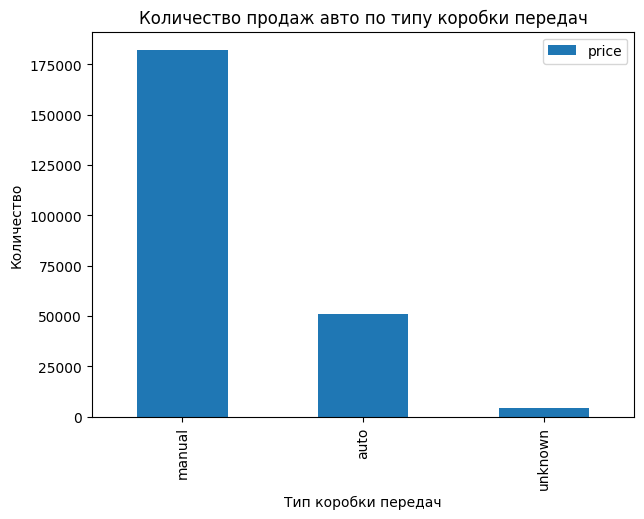

In [71]:
df_gearbox_count.plot(kind='bar', y='price', figsize=(7, 5))
plt.legend()
plt.title('Количество продаж авто по типу коробки передач')
plt.xlabel('Тип коробки передач')
plt.ylabel('Количество')
plt.show()

In [72]:
print('Размер полученных данных:', df.shape, 'Количество ячеек:', df.size)

Размер полученных данных: (237085, 10) Количество ячеек: 2370850


In [73]:
df.head()

,price,vehicle_type,registration_year,gearbox,power,model,kilometer,fuel_type,brand,repaired
1,18300,coupe,2011,manual,190,unknown,125000,gasoline,audi,yes
2,9800,suv,2004,auto,163,grand,125000,gasoline,jeep,unknown
3,1500,small,2001,manual,75,golf,150000,petrol,volkswagen,no
4,3600,small,2008,manual,69,fabia,90000,gasoline,skoda,no
5,650,sedan,1995,manual,102,3er,150000,petrol,bmw,yes


In [74]:
#df = df.copy().reset_index(drop=True)
print(df.info())
display(df.head())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 237085 entries, 1 to 354368
Data columns (total 10 columns):
 #   Column             Non-Null Count   Dtype 
---  ------             --------------   ----- 
 0   price              237085 non-null  int64 
 1   vehicle_type       237085 non-null  object
 2   registration_year  237085 non-null  int64 
 3   gearbox            237085 non-null  object
 4   power              237085 non-null  int64 
 5   model              237085 non-null  object
 6   kilometer          237085 non-null  int64 
 7   fuel_type          237085 non-null  object
 8   brand              237085 non-null  object
 9   repaired           237085 non-null  object
dtypes: int64(4), object(6)
memory usage: 19.9+ MB
None


,price,vehicle_type,registration_year,gearbox,power,model,kilometer,fuel_type,brand,repaired
1,18300,coupe,2011,manual,190,unknown,125000,gasoline,audi,yes
2,9800,suv,2004,auto,163,grand,125000,gasoline,jeep,unknown
3,1500,small,2001,manual,75,golf,150000,petrol,volkswagen,no
4,3600,small,2008,manual,69,fabia,90000,gasoline,skoda,no
5,650,sedan,1995,manual,102,3er,150000,petrol,bmw,yes


Алгоритмы машинного обучения принимают на вход числовые значения. Таким образом, мы должны манипулировать этими типами категорий, чтобы они были в правильном формате, приемлемом для этих алгоритмов обучения.

Предоставлены исходные данные в размере 354 369 строк с индексацией 0-354368 и 16 столбцов. Типы столбцов корректные, названия столбцов и названия брендов автомобилей проиведены к корректному виду (приведены к нижнему регистру, удалены пробелы в начале и в конце наименования).
В результате предобработки данных были удалены 4 явных дубликата и неинформатиные столбцы ( столбцы с датами: 'date_crawled' (дата скачивания анкеты из базы), 'registration_month' (месяц регистрации автомобиля), 'date_created' (дата создания анкеты), 'last_seen' (дата последней активности пользователя); столбец 'number_of_pictures' (количество фотографий автомобиля) имеет нулевые данные и, соответственно, не информативен; 'postal_code' (почтовый индекс владельца) не влияет на цену)<br> Удалены выбросы в столбцах 'price', 'registration_year', 'power', 'kilometr'. В категориальных переменнтых оставшиеся пропуски заменены на 'unknown'. В итоге количество строк сократилось на с 354369 до 232332, а количество столбцов на с 16 до 10.<br> В результате исследования выявлены топовые автомобили по брендам, по типам кузова, по типу топлива и по типу коробки передач.<br><br> Для дальнейшего обучения моделей постребуется кодировка категориальных признаков. Для преобразования данных выберем методику порядкового кодирования Original Encoding для работы с моделями, основанными на деревьях - дерево решений, случайный лес, градиентный бустинг. Для линейных моделей используем прямое кодирование One Hot Encoding. 

## Обучение моделей

Кодирование данных:
1. Базовые - features
2. Кодировка Original Encoding - ord_features
3. Кодировка One Hot Encoding - ohe_features

In [75]:
# признаки
features = df.drop(['price'], axis=1)
# целевой признак
target = df['price']
print(features.shape)
print(target.shape)

(237085, 9)
(237085,)


In [76]:
features.head(3)

,vehicle_type,registration_year,gearbox,power,model,kilometer,fuel_type,brand,repaired
1,coupe,2011,manual,190,unknown,125000,gasoline,audi,yes
2,suv,2004,auto,163,grand,125000,gasoline,jeep,unknown
3,small,2001,manual,75,golf,150000,petrol,volkswagen,no


In [77]:
features.isna().sum()

vehicle_type         0
registration_year    0
gearbox              0
power                0
model                0
kilometer            0
fuel_type            0
brand                0
repaired             0
dtype: int64

In [78]:
target.isna().sum()

0

In [79]:
# Определим random_state
RANDOM_STATE=12345

In [80]:
# определяем категориальные признаки

cat_features = ['vehicle_type', 'gearbox', 'model', 'fuel_type', 'gearbox', 'brand']

In [81]:
# функция для оценки важности признаков

def importances(model, features):
    features=features.columns
    importances = model.feature_importances_
    indices = np.argsort(importances)
    
    plt.figure(figsize=(11, 5))
    plt.title('Важность функции')
    plt.barh(range(len(indices)), importances[indices], color='#6495ED', align='center')
    plt.yticks(range(len(indices)), features[indices])
    plt.xlabel('Относительная важность')
    plt.show()
        
    feat_importances = pd.Series(importances, index=features).sort_values(ascending=False)
    feat_importances = feat_importances.to_frame()
    feat_importances.columns=['Относительная важность']
    display(feat_importances)

### LinearRegression

Для LinearRegression используем One-hot-encoding

In [82]:
ohe_df = df.copy()

In [83]:
#OHE кодирование: One-hot-encoding: получение дамми-признаков (для лин моделей)

ohe_df = pd.get_dummies(ohe_df, drop_first=True)
ohe_df.shape

(237085, 311)

In [84]:
# признаки
ohe_features = ohe_df.drop(['price'], axis=1)

# целевой признак
ohe_target = ohe_df['price']
print(ohe_features.shape)
print(ohe_target.shape)

(237085, 310)
(237085,)


In [85]:
ohe_features.head(3)

,registration_year,power,kilometer,vehicle_type_convertible,vehicle_type_coupe,vehicle_type_other,vehicle_type_sedan,vehicle_type_small,vehicle_type_suv,vehicle_type_unknown,...,brand_smart,brand_sonstige_autos,brand_subaru,brand_suzuki,brand_toyota,brand_trabant,brand_volkswagen,brand_volvo,repaired_unknown,repaired_yes
1,2011,190,125000,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
2,2004,163,125000,0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,1,0
3,2001,75,150000,0,0,0,0,1,0,0,...,0,0,0,0,0,0,1,0,0,0


In [86]:
# делим данные на обучающую train и валидационную + тестовую выборки (valid_test)
# в соотношении 60/40
ohe_features_train, ohe_features_valid_test, ohe_target_train, ohe_target_valid_test = train_test_split(
    ohe_features, ohe_target, test_size=0.4, random_state=RANDOM_STATE)

In [87]:
# делим данные валидационную + тестовую выборки (valid_test) в соотношении 50/50
ohe_features_valid, ohe_features_test, ohe_target_valid, ohe_target_test = train_test_split(
    ohe_features_valid_test, ohe_target_valid_test, test_size=0.5, random_state=RANDOM_STATE)

In [88]:
print('Размер обучающей выборки:')
print(ohe_features_train.shape)
print(ohe_target_train.shape)
print('Размер тестовой выборки:')
print(ohe_features_test.shape)
print(ohe_target_test.shape)
print('Размер валидационной выборки:')
print(ohe_features_valid.shape)
print(ohe_target_valid.shape)

Размер обучающей выборки:
(142251, 310)
(142251,)
Размер тестовой выборки:
(47417, 310)
(47417,)
Размер валидационной выборки:
(47417, 310)
(47417,)


Масштабирование признаков:

In [89]:
# список всех численных признаков 
list_ohe_fearures = list(ohe_features.columns)
print(list_ohe_fearures)
print(len(list_ohe_fearures))

['registration_year', 'power', 'kilometer', 'vehicle_type_convertible', 'vehicle_type_coupe', 'vehicle_type_other', 'vehicle_type_sedan', 'vehicle_type_small', 'vehicle_type_suv', 'vehicle_type_unknown', 'vehicle_type_wagon', 'gearbox_manual', 'gearbox_unknown', 'model_145', 'model_147', 'model_156', 'model_159', 'model_1_reihe', 'model_1er', 'model_200', 'model_2_reihe', 'model_300c', 'model_3_reihe', 'model_3er', 'model_4_reihe', 'model_500', 'model_5_reihe', 'model_5er', 'model_601', 'model_6_reihe', 'model_6er', 'model_7er', 'model_80', 'model_850', 'model_90', 'model_900', 'model_9000', 'model_911', 'model_a1', 'model_a2', 'model_a3', 'model_a4', 'model_a5', 'model_a6', 'model_a8', 'model_a_klasse', 'model_accord', 'model_agila', 'model_alhambra', 'model_almera', 'model_altea', 'model_amarok', 'model_antara', 'model_arosa', 'model_astra', 'model_auris', 'model_avensis', 'model_aveo', 'model_aygo', 'model_b_klasse', 'model_b_max', 'model_beetle', 'model_berlingo', 'model_bora', 'mo

In [90]:
numeric = list_ohe_fearures
print(numeric)
print(len(numeric))

['registration_year', 'power', 'kilometer', 'vehicle_type_convertible', 'vehicle_type_coupe', 'vehicle_type_other', 'vehicle_type_sedan', 'vehicle_type_small', 'vehicle_type_suv', 'vehicle_type_unknown', 'vehicle_type_wagon', 'gearbox_manual', 'gearbox_unknown', 'model_145', 'model_147', 'model_156', 'model_159', 'model_1_reihe', 'model_1er', 'model_200', 'model_2_reihe', 'model_300c', 'model_3_reihe', 'model_3er', 'model_4_reihe', 'model_500', 'model_5_reihe', 'model_5er', 'model_601', 'model_6_reihe', 'model_6er', 'model_7er', 'model_80', 'model_850', 'model_90', 'model_900', 'model_9000', 'model_911', 'model_a1', 'model_a2', 'model_a3', 'model_a4', 'model_a5', 'model_a6', 'model_a8', 'model_a_klasse', 'model_accord', 'model_agila', 'model_alhambra', 'model_almera', 'model_altea', 'model_amarok', 'model_antara', 'model_arosa', 'model_astra', 'model_auris', 'model_avensis', 'model_aveo', 'model_aygo', 'model_b_klasse', 'model_b_max', 'model_beetle', 'model_berlingo', 'model_bora', 'mo

In [91]:
scaler = StandardScaler()
scaler.fit(ohe_features_train[numeric])

StandardScaler()

In [92]:
ohe_features_train[numeric] = scaler.transform(ohe_features_train[numeric])


In [93]:
ohe_features_test[numeric] = scaler.transform(ohe_features_test[numeric])
ohe_features_valid[numeric] = scaler.transform(ohe_features_valid[numeric])

In [94]:
%%time

model_LR = LinearRegression()
start_model_LR = time.time() # время начала 
# обучим модель линейной регрессии
model_LR.fit(ohe_features_train, ohe_target_train)
end_model_LR = time.time() # время окончания
fit_time_model_LR = end_model_LR - start_model_LR
print('Время обучения model_LR', fit_time_model_LR)

Время обучения model_LR 3.3101227283477783
CPU times: total: 8.23 s
Wall time: 3.31 s


In [95]:
%%time

start_model_LR = time.time() # время начала 
# прогноз
predictions_LR = model_LR.predict(ohe_features_valid)
end_model_LR = time.time()
predict_time_model_LR = end_model_LR - start_model_LR
print('Время предсказания model_LR', predict_time_model_LR)

Время предсказания model_LR 0.13448309898376465
CPU times: total: 344 ms
Wall time: 134 ms


In [96]:
%%time

#найдем квадратичную среднюю ошибку (MSE)
#найдем корень из квадратичной средней ошибки (RMSE)
mse_LR = mean_squared_error(ohe_target_valid, predictions_LR)
rmse_LR = mse_LR ** 0.5
print('mse_LR', mse_LR)
print('rmse_LR', rmse_LR)


mse_LR 6820171.682544464
rmse_LR 2611.5458415552393
CPU times: total: 0 ns
Wall time: 0 ns


### DecisionTreeRegressor

In [97]:
df = df.copy()

In [98]:
# признаки
features = df.drop(['price'], axis=1)
# целевой признак
target = df['price']
print(features.shape)
print(target.shape)

(237085, 9)
(237085,)


In [99]:
# делим данные на обучающую train и валидационную + тестовую выборки (valid_test)
# в соотношении 60/40
features_train, features_valid_test, target_train, target_valid_test = train_test_split(
    features, target, test_size=0.4, random_state=12345)

In [100]:
# делим данные валидационную + тестовую выборки (valid_test) в соотношении 50/50
features_valid, features_test, target_valid, target_test = train_test_split(
    features_valid_test, target_valid_test, test_size=0.5, random_state=RANDOM_STATE)

In [101]:
features_train.head(3)

,vehicle_type,registration_year,gearbox,power,model,kilometer,fuel_type,brand,repaired
82671,wagon,2002,auto,170,c_klasse,150000,gasoline,mercedes_benz,no
17461,sedan,1997,manual,88,3_reihe,150000,petrol,mazda,no
342612,small,2004,manual,60,2_reihe,100000,petrol,peugeot,no


In [102]:
print('Размер обучающей выборки:')
print(features_train.shape)
print(target_train.shape)
print('Размер тестовой выборки:')
print(features_test.shape)
print(target_test.shape)
print('Размер валидационной выборки:')
print(features_valid.shape)
print(target_valid.shape)

Размер обучающей выборки:
(142251, 9)
(142251,)
Размер тестовой выборки:
(47417, 9)
(47417,)
Размер валидационной выборки:
(47417, 9)
(47417,)


In [103]:
#кодирую признаки через OE:
encoder = OrdinalEncoder(handle_unknown='use_encoded_value', unknown_value=-1)
# обучение Encoder (на тренировочной выборке)
encoder.fit(features_train)

OrdinalEncoder(handle_unknown='use_encoded_value', unknown_value=-1)

In [104]:
# преобразуем данные функцией transform()
ord_features_train = encoder.transform(features_train)
ord_features_test = encoder.transform(features_test)
ord_features_valid = encoder.transform(features_valid)

In [105]:
# реализуем обновленный датафрейм. Тип данных int
ord_features_train = pd.DataFrame(ord_features_train, columns = features_train.columns, dtype=int)
ord_features_valid = pd.DataFrame(ord_features_valid, columns = features_valid.columns, dtype=int)
ord_features_test = pd.DataFrame(ord_features_test, columns = features_test.columns, dtype=int)

In [106]:
# результат
display(ord_features_train.head(3))

,vehicle_type,registration_year,gearbox,power,model,kilometer,fuel_type,brand,repaired
0,8,26,0,167,59,12,2,20,0
1,4,21,1,85,10,12,6,19,0
2,5,28,1,57,8,10,6,25,0


In [107]:
# результат
display(ord_features_test.head(3))

,vehicle_type,registration_year,gearbox,power,model,kilometer,fuel_type,brand,repaired
0,2,28,0,167,76,12,6,20,0
1,4,31,1,119,6,12,6,2,0
2,8,26,0,132,232,12,2,24,2


In [108]:
# результат
display(ord_features_valid.head(3))

,vehicle_type,registration_year,gearbox,power,model,kilometer,fuel_type,brand,repaired
0,8,21,1,190,15,12,6,2,0
1,0,19,0,107,221,12,6,38,2
2,5,26,1,72,8,12,6,25,0


In [109]:
ord_features_train.isna().sum().sum()

0

In [110]:
ord_features_test.isna().sum().sum()

0

In [111]:
ord_features_valid.isna().sum().sum()

0

In [112]:
ss = StandardScaler()
ss.fit(ord_features_train)
# стандартизируем данные
scale_features_train = ss.transform(ord_features_train)
# реализуем обновленный датафрейм. Тип данных int
scale_features_train = pd.DataFrame(scale_features_train, columns = ord_features_train.columns)
scale_features_train.head(3)

scale_features_valid = ss.transform(ord_features_valid)
scale_features_valid = pd.DataFrame(scale_features_valid, columns = ord_features_valid.columns)
scale_features_test = ss.transform(ord_features_test)
scale_features_test = pd.DataFrame(scale_features_test, columns = ord_features_test.columns)

Глубина: 1
MSE для решающего дерева: 13678966.828250682
RMSE для решающего дерева: 3698.5087303196515
Глубина: 2
MSE для решающего дерева: 10476926.087746901
RMSE для решающего дерева: 3236.8080090958288
Глубина: 3
MSE для решающего дерева: 8780292.201084174
RMSE для решающего дерева: 2963.1557841403096
Глубина: 4
MSE для решающего дерева: 6989485.8182790885
RMSE для решающего дерева: 2643.763570798094
Глубина: 5
MSE для решающего дерева: 6043270.123449327
RMSE для решающего дерева: 2458.3063526438946
Глубина: 6
MSE для решающего дерева: 5365219.951908783
RMSE для решающего дерева: 2316.2944441302757
Глубина: 7
MSE для решающего дерева: 4862881.2581359325
RMSE для решающего дерева: 2205.1941542947943
Глубина: 8
MSE для решающего дерева: 4459674.355974519
RMSE для решающего дерева: 2111.7941083293417
Глубина: 9
MSE для решающего дерева: 4220986.079416024
RMSE для решающего дерева: 2054.5038523731278
Глубина: 10
MSE для решающего дерева: 4024791.428503192
RMSE для решающего дерева: 2006.

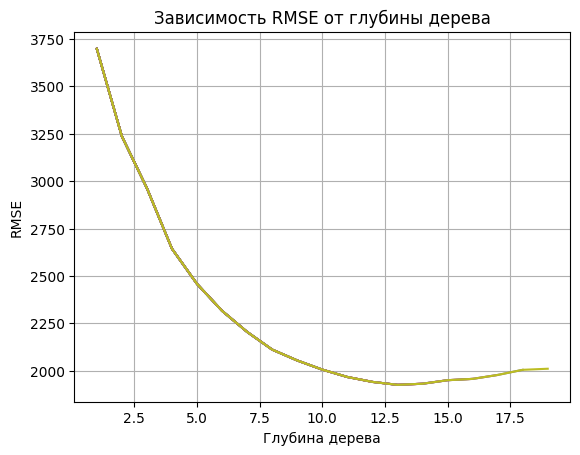

In [113]:
%%time

# модель дерева решений на OE выборках

best_rmse_DTR = 5000
best_depth_DTR = 0
depths = []
results = []

for depth in range(1, 20):
    model_DTR = DecisionTreeRegressor(max_depth=depth, random_state=RANDOM_STATE)
    model_DTR.fit(scale_features_train, target_train)
    predictions_DTR = model_DTR.predict(scale_features_valid)
    mse_DTR = mean_squared_error(target_valid, predictions_DTR)
    rmse_DTR = mse_DTR**0.5
    print('Глубина:', depth)
    print('MSE для решающего дерева:', mse_DTR)
    print('RMSE для решающего дерева:', rmse_DTR)
    depths.append(depth)
    results.append(rmse_DTR)
    plt.plot(depths, results)
    plt.title("Зависимость RMSE от глубины дерева")
    plt.xlabel("Глубина дерева")
    plt.ylabel("RMSE")
    plt.grid()
    plt.show
    
    if rmse_DTR < best_rmse_DTR:
        best_rmse_DTR = rmse_DTR
        best_depth_DTR = depth
print()
print('Итог DecisionTreeRegressor, model_DTR')
print('RMSE для решающего дерева:', best_rmse_DTR)
print('Глубина дерева:', best_depth_DTR)

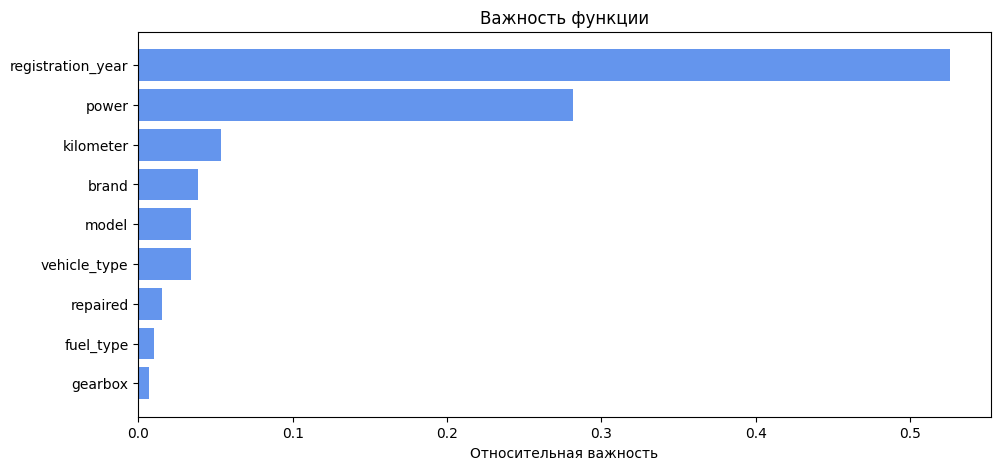

,Относительная важность
registration_year,0.525804
power,0.281441
kilometer,0.053732
brand,0.038802
model,0.034258
vehicle_type,0.034027
repaired,0.015113
fuel_type,0.009949
gearbox,0.006874


In [114]:
importances(model_DTR, scale_features_valid)

In [115]:
%%time

start_model_DTR = time.time() # время начала 
# модель с лучшим параметром
model_DTR = DecisionTreeRegressor(max_depth=best_depth_DTR, random_state=RANDOM_STATE)
# обучение
model_DTR.fit(scale_features_train, target_train)

end_model_DTR = time.time() # время окончания
fit_time_model_DTR = end_model_DTR - start_model_DTR
print('Время обучения model_DTR', fit_time_model_DTR)

Время обучения model_DTR 0.40088391304016113
CPU times: total: 312 ms
Wall time: 401 ms


In [116]:
%%time
start_model_DTR = time.time()
# прогноз
predictions_DTR = model_DTR.predict(scale_features_valid)
end_model_DTR = time.time() # время окончания
predict_time_model_DTR = end_model_DTR - start_model_DTR
print('Время предсказания model_DTR', predict_time_model_DTR)

Время предсказания model_DTR 0.006982564926147461
CPU times: total: 0 ns
Wall time: 6.98 ms


In [117]:
%%time

mse_DTR = mean_squared_error(target_valid, predictions_DTR)
rmse_DTR = mse_DTR ** 0.5
print('MSE для решающего дерева:', mse_DTR)
print('RMSE для решающего дерева:', rmse_DTR)

MSE для решающего дерева: 3709279.415788407
RMSE для решающего дерева: 1925.9489650009957
CPU times: total: 0 ns
Wall time: 998 µs


### RandomForestRegressor

In [118]:
%%time

best_model_RFR = 10
best_rmse_RFR = 5000
best_depth_RFR = 0
best_est_RFR = 0
for est in range(5, 50, 5):
    for depth in range(2, 20, 2):
        model_RFR = RandomForestRegressor(random_state=RANDOM_STATE,
                                         n_estimators=est, max_depth=depth)
        model_RFR.fit(scale_features_train, target_train)
        prediction_RFR = model_RFR.predict(scale_features_valid)
        mse_RFR = mean_squared_error(target_valid, prediction_RFR)
        rmse_RFR = mean_squared_error(target_valid, prediction_RFR)**0.5
        if rmse_RFR < best_rmse_RFR:
            best_model_RFR = model_RFR
            best_rmse_RFR = rmse_RFR
            best_est_RFR = est
            best_depth_RFR = depth
print()
print('Итог RandomForestRegressor')
print('RMSE для случайного леса:', best_rmse_RFR)
print('Количество деревьев', best_est_RFR)
print('Глубина дерева:', best_depth_RFR)


Итог RandomForestRegressor
RMSE для случайного леса: 1672.6298671402576
Количество деревьев 40
Глубина дерева: 18
CPU times: total: 6min 6s
Wall time: 6min 46s


In [119]:
%%time

start_model_RFR = time.time() # время начала 
# обучаем модель с лучшими параметрами
model_RFR = RandomForestRegressor(random_state=RANDOM_STATE,
                                  n_estimators=best_est_RFR, max_depth=best_depth_RFR)
model_RFR.fit(scale_features_train, target_train)

end_model_RFR = time.time() # время окончания
fit_time_model_RFR = end_model_RFR - start_model_RFR
print('Время обучения model_RFR', fit_time_model_RFR)

Время обучения model_RFR 16.019084692001343
CPU times: total: 14.7 s
Wall time: 16 s


In [120]:
%%time

start_model_RFR = time.time() # время начала 
# прогноз
prediction_RFR = model_RFR.predict(scale_features_valid)
end_model_RFR = time.time() # время окончания
predict_time_model_RFR = end_model_RFR - start_model_RFR
print('Время предсказания model_RFR', predict_time_model_RFR)

Время предсказания model_RFR 0.3804020881652832
CPU times: total: 359 ms
Wall time: 380 ms


In [121]:
%%time
mse_RFR = mean_squared_error(target_valid, prediction_RFR)
rmse_RFR = mse_RFR ** 0.5
print('Итог RandomForestRegressor')
print('RMSE для случайного леса:', best_rmse_RFR)
print('Количество деревьев', best_est)
print('Глубина дерева:', best_depth)

Итог RandomForestRegressor
RMSE для случайного леса: 1672.6298671402576


NameError: name 'best_est' is not defined

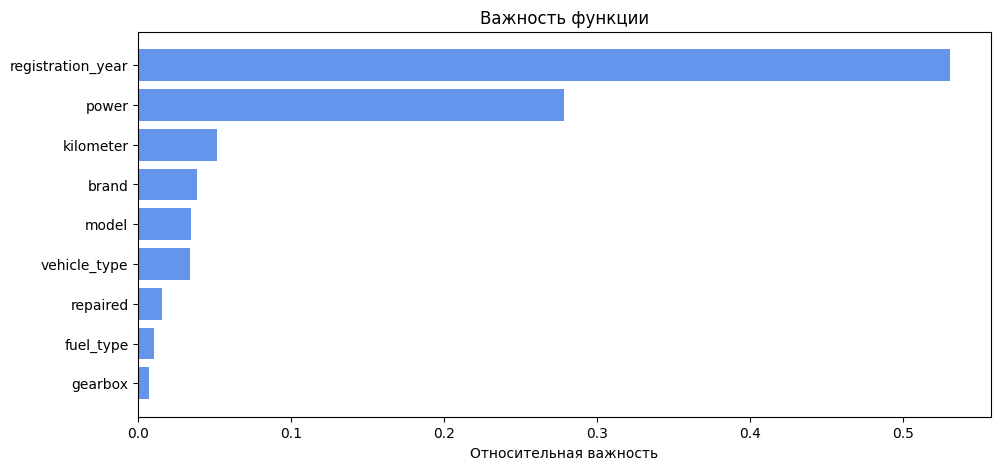

,Относительная важность
registration_year,0.531012
power,0.278526
kilometer,0.051690
brand,0.038686
model,0.034324
vehicle_type,0.033565
repaired,0.015354
fuel_type,0.010085
gearbox,0.006758


In [122]:
importances(model_RFR, scale_features_valid)

#### с RandomizedSearchCV

In [123]:
%%time
# подбираем лучшие гиперпараметры  n_estimators, max_depth, min_samples_leaf с RandomizedSearchCV,
# выбираем метрику настройки RMSE
n_estimators = range(1, 100)
max_depth = range(1, 50)
min_samples_leaf = range(1, 13)
  
hyperparameters = dict(
    max_depth = max_depth, 
    min_samples_leaf = min_samples_leaf, 
    n_estimators = n_estimators
)
RandomForest = RandomForestRegressor(random_state = RANDOM_STATE)

randomizedsearch = RandomizedSearchCV(
    RandomForest, hyperparameters, random_state = RANDOM_STATE, scoring='neg_root_mean_squared_error')
RFR_best_model_random = randomizedsearch.fit(scale_features_train, target_train)
print(RFR_best_model_random.best_estimator_)

RandomForestRegressor(max_depth=35, n_estimators=86, random_state=12345)
CPU times: total: 10min 43s
Wall time: 11min 25s


In [124]:
# выводим результаты кросс-валидации
results = pd.DataFrame(RFR_best_model_random.cv_results_)
print('RandomForestRegressor cv mean test score:', abs(results.mean_test_score.mean()).round(2))

RandomForestRegressor cv mean test score: 1980.56


In [125]:
%%time

start_model_RFR_SearchCV = time.time() # время начала 
# обучаем лучшую модель
model_RFR_SearchCV = RandomForestRegressor(
    random_state=RANDOM_STATE, max_depth=35, n_estimators=86)
model_RFR_SearchCV.fit(scale_features_train, target_train)
end_model_RFR_SearchCV = time.time() # время окончания
fit_time_model_RFR_SearchCV = end_model_RFR_SearchCV - start_model_RFR_SearchCV
print('Время обучения model_RFR_SearchCV', fit_time_model_RFR_SearchCV)

Время обучения model_RFR_SearchCV 49.48800444602966
CPU times: total: 46.7 s
Wall time: 49.5 s


In [126]:
%%time

start_model_RFR_SearchCV = time.time() # время начала 
# делаем прогноз с лучшей моделью, считаем RMSE
predictions_RFR_SearchCV = model_RFR_SearchCV.predict(scale_features_valid)
end_model_RFR_SearchCV = time.time() # время окончания
predict_time_model_RFR_SearchCV = end_model_RFR_SearchCV - start_model_RFR_SearchCV
print('Время предсказания model_RFR_SearchCV', predict_time_model_RFR_SearchCV)

Время предсказания model_RFR_SearchCV 1.1350150108337402
CPU times: total: 1.06 s
Wall time: 1.14 s


In [127]:
%%time

mse_RFR_SearchCV = mean_squared_error(target_valid, predictions_RFR_SearchCV)
rmse_RFR_SearchCV = mse_RFR_SearchCV ** 0.5
print('RMSE_RFR_SearchCV при RandomizedSearchCV по модели RandomForestRegressor_SearchCV')
print(rmse_RFR_SearchCV)

RMSE_RFR_SearchCV при RandomizedSearchCV по модели RandomForestRegressor_SearchCV
1688.882501619556
CPU times: total: 0 ns
Wall time: 0 ns


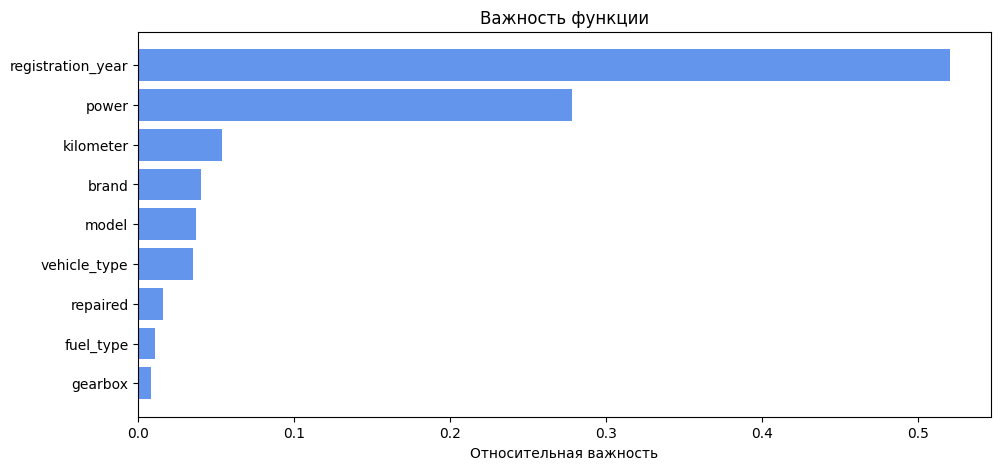

,Относительная важность
registration_year,0.520656
power,0.277929
kilometer,0.054033
brand,0.039999
model,0.037353
vehicle_type,0.035022
repaired,0.016018
fuel_type,0.011015
gearbox,0.007976


In [128]:
importances(model_RFR_SearchCV, scale_features_train)

### CatBoostRegressor

Это библиотека с открытым исходным кодом, основанная на деревьях решений повышения градиента

In [129]:
# создаем список категориальных параметров
cat_features = features_train.select_dtypes(include=['object'])
print(list(cat_features))

['vehicle_type', 'gearbox', 'model', 'fuel_type', 'brand', 'repaired']


In [130]:
cat_features = ['vehicle_type', 'gearbox', 'model', 'fuel_type', 'brand', 'repaired']

In [131]:
#%%time

start_model_CBR = time.time() # время начала 
# обучение
model_CBR = CatBoostRegressor(loss_function='RMSE', random_state=RANDOM_STATE)
model_CBR.fit(features_train, target_train, cat_features, verbose=10)
end_model_CBR = time.time() # время окончания

fit_time_model_CBR = end_model_CBR - start_model_CBR
print('Время обучения model_CBR', fit_time_model_CBR)

Learning rate set to 0.089611
0:	learn: 4371.0256367	total: 264ms	remaining: 4m 23s
10:	learn: 2792.2742038	total: 1.26s	remaining: 1m 53s
20:	learn: 2234.6745709	total: 2.28s	remaining: 1m 46s
30:	learn: 2004.4773183	total: 3.28s	remaining: 1m 42s
40:	learn: 1913.8511970	total: 4.09s	remaining: 1m 35s
50:	learn: 1861.4116734	total: 5.03s	remaining: 1m 33s
60:	learn: 1826.4013129	total: 5.87s	remaining: 1m 30s
70:	learn: 1803.3691121	total: 6.68s	remaining: 1m 27s
80:	learn: 1782.1225372	total: 7.5s	remaining: 1m 25s
90:	learn: 1766.9587334	total: 8.3s	remaining: 1m 22s
100:	learn: 1750.8040052	total: 9.18s	remaining: 1m 21s
110:	learn: 1735.4332068	total: 10.2s	remaining: 1m 21s
120:	learn: 1724.6562163	total: 11.1s	remaining: 1m 20s
130:	learn: 1715.4093920	total: 12s	remaining: 1m 19s
140:	learn: 1706.0610563	total: 12.9s	remaining: 1m 18s
150:	learn: 1697.4859400	total: 13.7s	remaining: 1m 17s
160:	learn: 1689.4282304	total: 14.6s	remaining: 1m 16s
170:	learn: 1682.5569985	total: 1

In [132]:
%%time

start_model_CBR = time.time() # время начала 
# прогноз
probabilities_valid_CBR = model_CBR.predict(features_valid)
end_model_CBR = time.time() # время окончания
predict_time_model_CBR = end_model_CBR - start_model_CBR
print('Время предсказания model_CBR', predict_time_model_CBR)

Время предсказания model_CBR 0.17664790153503418
CPU times: total: 672 ms
Wall time: 177 ms


In [133]:
%%time

rmse_CBR = mean_squared_error(target_valid, probabilities_valid_CBR)**0.5
print()
print(rmse_CBR)


1589.4550420212552
CPU times: total: 0 ns
Wall time: 0 ns


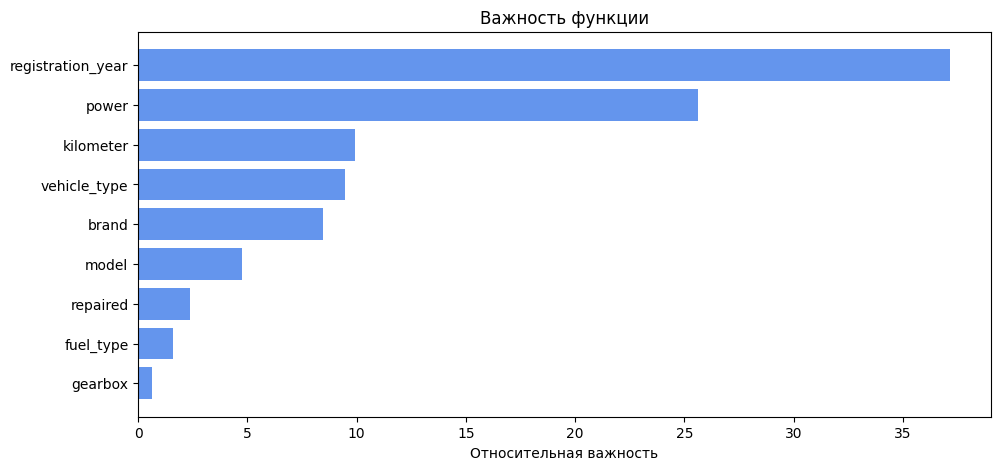

,Относительная важность
registration_year,37.169389
power,25.614851
kilometer,9.934475
vehicle_type,9.472083
brand,8.464482
model,4.754087
repaired,2.391234
fuel_type,1.573039
gearbox,0.626360


In [134]:
importances(model_CBR, features_train)

### LightGBMRegressor

LightGBM — это фреймворк, который предоставляет реализацию деревьев принятия решений с градиентным бустингом

In [135]:
# выделим признаки и целевой признак
target = df['price'].copy()
features = df.drop('price', axis=1).copy()

# переведем категориальные признаки в тип category, который требуется для LightGBM

for i in features.columns:
    col_type = features[i].dtype
    if col_type == 'object':
        features[i] = features[i].astype('category')

# делим данные на обучающую train и валидационную + тестовую выборки (valid_test)
# в соотношении 60/40
features_train, features_valid_test, target_train, target_valid_test = train_test_split(
    features, target, test_size=0.4, random_state=12345)    
# делим данные валидационную + тестовую выборки (valid_test) в соотношении 50/50
features_valid, features_test, target_valid, target_test = train_test_split(
    features_valid_test, target_valid_test, test_size=0.5, random_state=12345)

# проверим размер выборок
print(features_train.shape)
print(features_test.shape)

(142251, 9)
(47417, 9)


In [136]:
print(features_train.dtypes)

vehicle_type         category
registration_year       int64
gearbox              category
power                   int64
model                category
kilometer               int64
fuel_type            category
brand                category
repaired             category
dtype: object


#### LightGBMRegressor без подбора гиперпараметров

In [137]:
%%time

# построим модель без подбора гиперпараметров
start_model_LGBMR = time.time() # время начала 
model_LGBMR = lgb.LGBMRegressor(random_state=RANDOM_STATE)
model_LGBMR.fit(features_train, target_train)
end_model_LGBMR = time.time() # время окончания
fit_time_model_LGBMR = end_model_LGBMR - start_model_LGBMR
print('Время обучения model_LGBMR', fit_time_model_LGBMR)

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.004256 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 619
[LightGBM] [Info] Number of data points in the train set: 142251, number of used features: 9
[LightGBM] [Info] Start training from score 5299.160751
Время обучения model_LGBMR 0.7695925235748291
CPU times: total: 1.8 s
Wall time: 770 ms


In [138]:
%%time

start_model_LGBMR = time.time() # время начала
predictions_LGBMR = model_LGBMR.predict(features_valid)
end_model_LGBMR = time.time() # время окончания
predict_time_model_LGBMR = end_model_LGBMR - start_model_LGBMR
print('Время предсказания model_LGBMR', predict_time_model_LGBMR)

Время предсказания model_LGBMR 0.21156096458435059
CPU times: total: 484 ms
Wall time: 212 ms


In [139]:
%%time

rmse_LGBMR = mean_squared_error(target_valid, predictions_LGBMR)**0.5
print(rmse_LGBMR)

1613.6941316547948
CPU times: total: 0 ns
Wall time: 0 ns


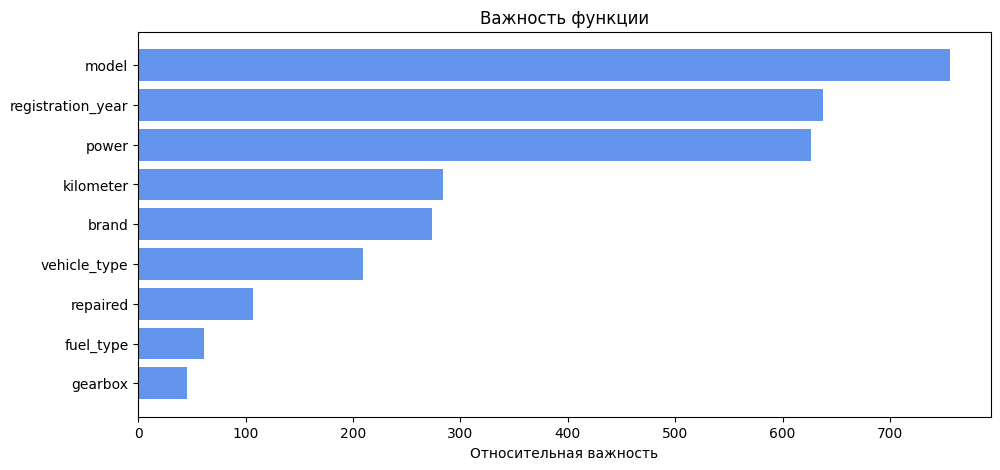

,Относительная важность
model,756
registration_year,638
power,626
kilometer,284
brand,274
vehicle_type,209
repaired,107
fuel_type,61
gearbox,45


In [140]:
importances(model_LGBMR, features_train)

#### LightGBMRegressor c GridSearchCV

Код закоментировала, так как подбор параметров происходит более часа, успешно завершился 1 раз, далее платформа не справлялась.
Результат rmse 1361.62. (Далее в Colab проверила работу). Время обучения модели  отличается от платформы яндекс.

In [141]:
# поиск гиперпараметров

#hyperparams = [{'n_estimators':[100, 500, 1000],  
                #'num_leaves': [n for n in range(30, 300, 30)]}]

In [142]:
#display(tuning_model_LGBMR_GCV.best_score_*-1)

In [143]:
#%%time

#start_model_LGBMR_GCV = time.time() # время начала
# обучение LightGBM
#model_LGBMR_GCV = lgb.LGBMRegressor(random_state=RANDOM_STATE,
                          #n_estimators=500,
                          #num_leaves=120))
#model_LGBMR_GCV.fit(features_train, target_train)
#end_model_LGBMR_GCV = time.time() # время окончания
#fit_time_model_LGBMR_GCV = end_model_LGBMR_GCV - start_model_LGBMR_GCV
#print('Время обучения model_LGBMR_GCV', fit_time_model_LGBMR_GCV)

In [144]:
#%%time

#start_model_LGBMR_GCV = time.time() # время начала
# прогноз 
#predictions_LGBMR_GCV = model_LGBMR_GCV.predict(features_valid)
#rmse_LGBMR_GCV = mean_squared_error(target_valid, predictions_LGBMR_GCV)**0.5
#print(rmse_LGBMR_GCV)
#end_model_LGBMR_GCV = time.time() # время окончания
#predict_time_model_LGBMR_GCV = end_model_LGBMR_GCV - start_model_LGBMR_GCV
#print('Время предсказания model_LGBMR_GCV', predict_time_model_LGBMR_GCV)

In [145]:
#importances(model_LGBMR_GCV, features_train)

## Анализ моделей

In [146]:
index = ['LinearRegression', 'DecisionTreeRegressor', 'RandomForestRegressor', 
         'RandomForestRegressor с RandomizedSearchCV', 'CatBoostRegressor', 
         'LightGBMRegressor без подбора параметров']

In [147]:
data = {'RMSE':[rmse_LR,
                rmse_DTR,
                rmse_RFR,
                rmse_RFR_SearchCV,
                rmse_CBR,
                rmse_LGBMR], 
        
        'fit_time':[fit_time_model_LR,
                   fit_time_model_DTR,
                   fit_time_model_RFR,
                   fit_time_model_RFR_SearchCV,
                   fit_time_model_CBR,
                   fit_time_model_LGBMR],
        
        'predict_time':[predict_time_model_LR,
                       predict_time_model_DTR,
                       predict_time_model_RFR, 
                       predict_time_model_RFR_SearchCV,
                       predict_time_model_CBR,
                       predict_time_model_LGBMR]
       }

In [148]:
d_model = pd.DataFrame(data=data, index=index)
d_model

,RMSE,fit_time,predict_time
LinearRegression,2611.545842,3.310123,0.134483
DecisionTreeRegressor,1925.948965,0.400884,0.006983
RandomForestRegressor,1672.629867,16.019085,0.380402
RandomForestRegressor с RandomizedSearchCV,1688.882502,49.488004,1.135015
CatBoostRegressor,1589.455042,90.755950,0.176648
LightGBMRegressor без подбора параметров,1613.694132,0.769593,0.211561


Лучшая модель с лучшим rmse оказалась модель CatBoostRegressor: лучшая rmse, время обучения разы меньше,
чем у LightGBMRegressor без подбора параметров. По метрике rmse хорошие результаты показали RandomForestRegressor, RandomForestRegressor с RandomizedSearchCV, CatBoostRegressor и LightGBMRegressor без подбора параметров. Худшая модель LinearRegression - не прошла порог rmse = 2500.

In [149]:
# поверка лучшей модели на тестовой выборке

In [150]:
#%%time

# обучение
model_CBR = CatBoostRegressor(loss_function='RMSE')
model_CBR.fit(features_train, target_train, cat_features, verbose=10)

Learning rate set to 0.089611
0:	learn: 4378.4872026	total: 111ms	remaining: 1m 50s
10:	learn: 2785.1340107	total: 1.14s	remaining: 1m 42s
20:	learn: 2220.1846655	total: 2.05s	remaining: 1m 35s
30:	learn: 1994.7993835	total: 2.9s	remaining: 1m 30s
40:	learn: 1904.7027381	total: 3.71s	remaining: 1m 26s
50:	learn: 1857.6111314	total: 4.54s	remaining: 1m 24s
60:	learn: 1821.8264915	total: 5.4s	remaining: 1m 23s
70:	learn: 1797.3152300	total: 6.26s	remaining: 1m 21s
80:	learn: 1776.4998784	total: 7.05s	remaining: 1m 20s
90:	learn: 1761.0808631	total: 7.9s	remaining: 1m 18s
100:	learn: 1746.6068775	total: 8.75s	remaining: 1m 17s
110:	learn: 1733.8593909	total: 9.62s	remaining: 1m 17s
120:	learn: 1721.6259899	total: 10.5s	remaining: 1m 16s
130:	learn: 1711.9155613	total: 11.3s	remaining: 1m 15s
140:	learn: 1703.4375472	total: 12.2s	remaining: 1m 14s
150:	learn: 1695.4969037	total: 13.2s	remaining: 1m 14s
160:	learn: 1686.5253643	total: 14.3s	remaining: 1m 14s
170:	learn: 1681.0125296	total: 

In [151]:
%%time

# прогноз
probabilities_test_CBR = model_CBR.predict(features_test)

CPU times: total: 516 ms
Wall time: 99.8 ms


In [152]:
%%time

rmse_CBR = mean_squared_error(target_test, probabilities_test_CBR)**0.5
print()
print(rmse_CBR)


1590.3522607658492
CPU times: total: 0 ns
Wall time: 997 µs


## Вывод

Были предоставлены исходные данные в размере 354 369 строк с индексацией 0-354368 и 16 столбцов. Типы столбцов корректные, названия столбцов и названия брендов автомобилей проиведены к корректному виду (приведены к нижнему регистру, удалены пробелы в начале и в конце наименования).<br> В результате предобработки данных были удалены 4 явных дубликата и неинформатиные столбцы ( столбцы с датами: 'date_crawled' (дата скачивания анкеты из базы), 'registration_month' (месяц регистрации автомобиля), 'date_created' (дата создания анкеты), 'last_seen' (дата последней активности пользователя); столбец 'number_of_pictures' (количество фотографий автомобиля) имеет нулевые данные и, соответственно, не информативен; 'postal_code' (почтовый индекс владельца) не влияет на цену)<br>Удалены выбросы в столбцах 'price', 'registration_year', 'power', 'kilometr'.<br> В категориальных переменнтых оставшиеся пропуски заменены на 'unknown'. В итоге количество строк сократилось на с 354369 до 232332, а количество столбцов на с 16 до 10.<br>
В результате исследования выявлены топовые автомобили по брендам, по типам кузова, по типу топлива и по типу коробки передач.<br>Для дальнейшего обучения моделей использовали кодировку категориальных признаков. Для преобразования данных - методику порядкового кодирования Original Encoding для работы с моделями, основанными на деревьях - дерево решений, случайный лес. Для линейных моделей используем прямое кодирование One Hot Encoding. Для остальных моделей - незакодированные данные.

По важности признаков во всех моделях, кроме LightGBMRegressor без подбора параметров, лидировали признаки: <br> -год регистрации автомобиля, <br> -мощность, <br> -пробег, <br> -марка и бренд. <br>У LightGBMRegressor без подбора параметров: <br>-марка <br> -год регистрации автомобиля, <br> -мощность, <br> -пробег, <br> -бренд. 

Лучшая модель с лучшим rmse оказалась модель CatBoostRegressor: лучшая rmse, время обучения разы меньше,
чем у LightGBMRegressor без подбора параметров. По метрике rmse хорошие результаты показали RandomForestRegressor, RandomForestRegressor с RandomizedSearchCV, CatBoostRegressor и LightGBMRegressor без подбора параметров. Худшая модель LinearRegression- не прошла порог rmse = 2500.<br> (Если брать в расчет закомментированную модель LightGBMRegressor c GridSearchCV, то она оказалась лучшей с rmse 1361.62).